<a href="https://colab.research.google.com/github/tcglarry/kg_power_line/blob/master/vsb_power_line_eda.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:

# Step 1
# Install a Drive FUSE wrapper.
# https://github.com/astrada/google-drive-ocamlfuse
!apt-get install -y -qq software-properties-common python-software-properties module-init-tools
!add-apt-repository -y ppa:alessandro-strada/ppa 2>&1 > /dev/null
!apt-get update -qq 2>&1 > /dev/null
!apt-get -y install -qq google-drive-ocamlfuse fuse


E: Package 'python-software-properties' has no installation candidate
Selecting previously unselected package google-drive-ocamlfuse.
(Reading database ... 110842 files and directories currently installed.)
Preparing to unpack .../google-drive-ocamlfuse_0.7.1-0ubuntu3~ubuntu18.04.1_amd64.deb ...
Unpacking google-drive-ocamlfuse (0.7.1-0ubuntu3~ubuntu18.04.1) ...
Setting up google-drive-ocamlfuse (0.7.1-0ubuntu3~ubuntu18.04.1) ...
Processing triggers for man-db (2.8.3-2ubuntu0.1) ...


In [2]:

# Step 2
from google.colab import drive
drive.mount('/content/drive')


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [3]:
!pip install pyarrow

    100% |████████████████████████████████| 11.6MB 3.8MB/s 


In [0]:
!sudo chmod 444 'drive/My Drive/kaggle/vsb_power_line/data/train.parquet'

In [0]:
!cp 'drive/My Drive/kaggle/vsb_power_line/data/train.parquet' .

In [0]:
#!ls -l 'drive/My Drive/kaggle/vsb_power_line/data/train.parquet'

-r-------- 1 root root 3811038936 Dec 19 23:58 'drive/My Drive/kaggle/vsb_power_line/data/train.parquet'


In [0]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [0]:
src= 'drive/My Drive/kaggle/vsb_power_line/data/'

In [0]:
import pandas as pd
import pyarrow.parquet as pq
#train_df = pq.read_pandas('train.parquet').to_pandas()
subset_train = pq.read_pandas('train.parquet', columns=[str(i) for i in range(999)]).to_pandas()

In [24]:
signals = np.array(subset_train).T.reshape((999//3, 3, 800000))
signals.shape

(333, 3, 800000)

In [0]:
#subset_train.head()

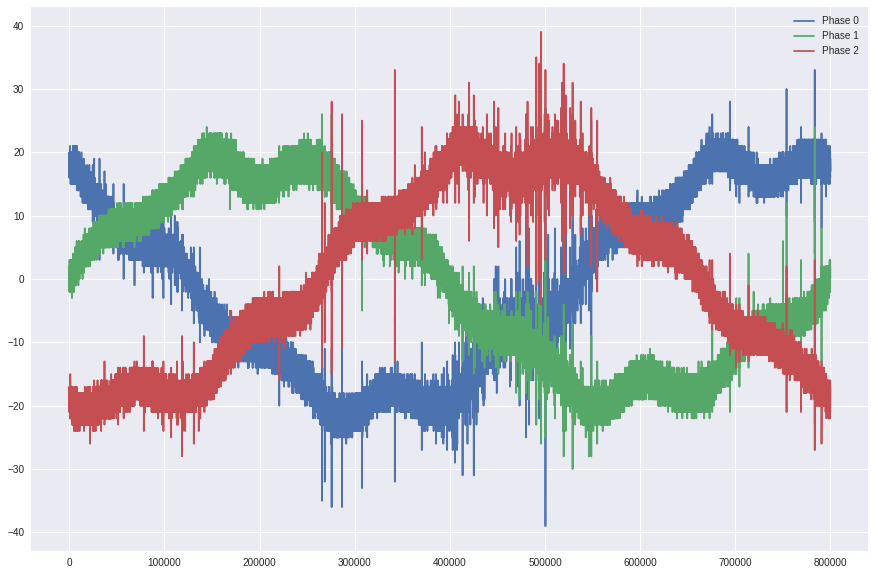

In [26]:
plt.figure(figsize=(15, 10))
plt.plot(signals[0, 0, :], label='Phase 0')
plt.plot(signals[0, 1, :], label='Phase 1')
plt.plot(signals[0, 2, :], label='Phase 2')
plt.legend()
plt.show()

In [0]:
def sample(signal, kernel_size):
    sampled = np.zeros((signal.shape[0], signal.shape[1], signal.shape[2]//kernel_size))
    print ('sampledshape',sampled.shape)
    for i in range(signal.shape[2]//kernel_size):
        begin = kernel_size * i
        print (f'begin = {begin}')
        end = min(kernel_size * (i + 1), signal.shape[2])
        print (f'end = {end}')
        sampled[:, :, i] = np.mean(signal[:, :, begin:end], axis=2)
        print (f'from begin {begin } to end {end} mean value {sampled[:, :, i] } selected ')
    return sampled

In [32]:
sampled = sample(signals, 100)

sampledshape (333, 3, 8000)
begin = 0
end = 100
from begin 0 to end 100 mean value [[ 1.772e+01  1.000e-01 -1.927e+01]
 [-1.648e+01 -5.340e+00  1.946e+01]
 [-1.586e+01  1.612e+01 -1.020e+00]
 [-1.523e+01 -9.390e+00  2.297e+01]
 [-7.700e-01 -1.679e+01  1.663e+01]
 [-7.920e+00  1.730e+01 -1.025e+01]
 [ 1.875e+01 -9.790e+00 -1.364e+01]
 [-7.700e+00  2.242e+01 -1.506e+01]
 [-2.092e+01  1.348e+01  4.330e+00]
 [-1.921e+01  1.730e+00  1.547e+01]
 [ 1.488e+01 -1.490e+00 -1.667e+01]
 [ 3.900e+00  1.522e+01 -2.106e+01]
 [ 8.660e+00 -1.579e+01  7.070e+00]
 [ 9.850e+00 -1.754e+01  5.490e+00]
 [-1.752e+01  1.677e+01 -1.230e+00]
 [-8.360e+00  1.590e+01 -1.362e+01]
 [-4.670e+00  1.918e+01 -1.590e+01]
 [ 1.455e+01  2.660e+00 -2.071e+01]
 [-1.826e+01 -3.270e+00  2.070e+01]
 [-1.948e+01  1.424e+01  2.160e+00]
 [-3.660e+00 -1.777e+01  1.889e+01]
 [-3.840e+00  2.244e+01 -1.835e+01]
 [-1.455e+01  1.605e+01 -3.950e+00]
 [ 3.590e+00  1.228e+01 -1.779e+01]
 [-1.625e+01  1.871e+01 -9.840e+00]
 [ 1.235e+01 -1.9

KeyboardInterrupt: ignored

In [0]:
#tt


In [12]:
train_csv_df = pd.read_csv(src+'metadata_train.csv')
train_csv_df.head()

,signal_id,id_measurement,phase,target
0,0,0,0,0
1,1,0,1,0
2,2,0,2,0
3,3,1,0,1
4,4,1,1,1


In [29]:
train_csv_df.shape

(8712, 4)

In [28]:
target = train_csv_df['target'][::3]
target.shape

(2904,)

In [15]:
train_csv_df.describe()

,signal_id,id_measurement,phase,target
count,8712.000000,8712.000000,8712.000000,8712.000000
mean,4355.500000,1451.500000,1.000000,0.060262
std,2515.082106,838.360658,0.816543,0.237985
min,0.000000,0.000000,0.000000,0.000000
25%,2177.750000,725.750000,0.000000,0.000000
50%,4355.500000,1451.500000,1.000000,0.000000
75%,6533.250000,2177.250000,2.000000,0.000000
max,8711.000000,2903.000000,2.000000,1.000000


In [18]:
train_csv_df['id_measurement'].value_counts()

2047    3
1130    3
1114    3
1106    3
1098    3
1090    3
1082    3
1074    3
1066    3
1058    3
1050    3
1042    3
1034    3
1026    3
1018    3
1010    3
1002    3
994     3
986     3
978     3
970     3
1122    3
1138    3
1314    3
1146    3
1298    3
1290    3
1282    3
1274    3
1266    3
       ..
397     3
2444    3
389     3
2436    3
381     3
2428    3
373     3
2500    3
453     3
2508    3
501     3
533     3
2580    3
525     3
2572    3
517     3
2564    3
509     3
2556    3
2548    3
461     3
493     3
2540    3
485     3
2532    3
477     3
2524    3
469     3
2516    3
0       3
Name: id_measurement, Length: 2904, dtype: int64